# Machine Learning - Recommender System

---

#### **Load  Data & libraries**

In [47]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import dtale

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly.offline import iplot, init_notebook_mode

from sklearn.cluster import KMeans
from pyproj import CRS, Transformer
from sklearn.preprocessing import StandardScaler, RobustScaler, MinMaxScaler

In [48]:
data = pd.read_csv('../Divar Dataset/Divar.csv')
data.drop('Unnamed: 0', axis=1, inplace=True)

/var/folders/9y/lpsdwq1d0bz2t5178sr1rgmr0000gn/T/ipykernel_1801/1300283319.py:1: DtypeWarning:

Columns (11,27,29,53) have mixed types. Specify dtype option on import or set low_memory=False.



In [50]:
# # d-tale
# d = dtale.show(data)
# d.open_browser()

## **Part 1** <br>
Clustering Data Using K-Means Algorithm with 10 Clusters

### **Preprocessing**

In [168]:
# Feature selection
part_1_data = data.copy()
part_1_data.shape

(1000000, 60)

Calculate a comparable price for each property:

In [171]:
# Price transformation
data['transformed_price'] = np.where(
    data['price_value'].notna(),
    data['price_value'],
    data['credit_value'] + (data['rent_value'] / 30000) * 1000000
)

**Features to select:** `location_latitude`, `location_longitude`, and `transformed_price`

In [172]:
part_1_data = data[['location_latitude', 'location_longitude', 'transformed_price']]
part_1_data

,location_latitude,location_longitude,transformed_price
0,35.811684,50.936600,NaN
1,NaN,NaN,8.500000e+09
2,35.703865,51.373459,1.616667e+09
3,NaN,NaN,4.116667e+09
4,NaN,NaN,5.750000e+09
...,...,...,...
999995,34.350235,47.083241,7.470000e+09
999996,35.770454,51.369099,2.500000e+09
999997,NaN,NaN,3.200000e+09
999998,37.483501,49.438721,NaN


#### **Handling Missings:**
Drop values that have missings

In [150]:
part_1_data = part_1_data.dropna()
part_1_data.shape

(606910, 3)

In [151]:
# # Digits conversion to english
# def persian_to_english_digits(text):
#     if pd.isna(text):
#         return text

#     persian_digits = "۰۱۲۳۴۵۶۷۸۹"
#     english_digits = "0123456789"

#     translation_table = str.maketrans(persian_digits, english_digits)
#     return str(text).translate(translation_table)


# part_1_data['construction_year'] = part_1_data.loc[:, 'construction_year'].apply(
#     lambda x: persian_to_english_digits(x) if isinstance(x, str) else x)

# # change to only digits
# part_1_data['construction_year'] = part_1_data['construction_year'].replace('قبل از 1370', '1370')

# # change to numeric type
# part_1_data['construction_year'] = pd.to_numeric(part_1_data['construction_year'], errors='coerce')
# part_1_data['construction_year'].shape

In [152]:
# import jdatetime

# current_jalali_year = jdatetime.date.today().year

# part_1_data["building_age"] = current_jalali_year - part_1_data["construction_year"]
# part_1_data = part_1_data.drop("construction_year", axis=1)

Show statistic summary:

In [153]:
part_1_data.describe()

,location_latitude,location_longitude,transformed_price
count,606910.000000,606910.000000,6.069100e+05
mean,34.998485,51.634878,4.089672e+11
std,2.337019,3.144181,5.606060e+13
min,23.636976,40.162369,0.000000e+00
25%,34.619293,50.747288,5.333333e+08
50%,35.722771,51.351130,1.550000e+09
75%,36.288515,51.783497,3.900000e+09
max,40.358055,74.511620,3.433333e+16


Convert geographical coordinates to UTM format:

In [154]:
# Create and find UTM zones
part_1_data['utm_zone'] = (np.floor((part_1_data['location_longitude'] + 180) / 6) + 1).astype(int)

print("Zones are: ", part_1_data['utm_zone'].unique())

Zones are:  [39 40 38 41 43 37]


/var/folders/9y/lpsdwq1d0bz2t5178sr1rgmr0000gn/T/ipykernel_1801/811164992.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [155]:
def apply_utm_conversion(group):
    """
    Apply UTM conversion.
    """
    # Extract the UTM zone number
    zone = group.name
    # Define coordinate reference systems
    wgs84_crs = CRS.from_epsg(4326)
    utm_crs = CRS.from_epsg(32600 + zone)

    # Create a coordinate transformer
    transformer = Transformer.from_crs(wgs84_crs, utm_crs, always_xy=True)
    
    # Convert all points in the group
    easting, northing = transformer.transform(
        group['location_longitude'].values,
        group['location_latitude'].values
    )
    
    # Convert all points in the group
    group['utm_easting'] = easting
    group['utm_northing'] = northing
    return group

In [156]:
# Apply UTM conversion
part_1_data = part_1_data.groupby(['utm_zone'], group_keys=False).apply(apply_utm_conversion, include_groups=False)
part_1_data['utm_zone'] = (np.floor((part_1_data['location_longitude'] + 180) / 6) + 1).astype(int)
part_1_data.head()

,location_latitude,location_longitude,transformed_price,utm_easting,utm_northing,utm_zone
2,35.703865,51.373459,1.616667e+09,533784.424602,3.951168e+06,39
7,35.729832,51.505466,8.700000e+09,545711.558185,3.954101e+06,39
8,35.712364,50.794781,6.500000e+08,481437.130969,3.952066e+06,39
10,35.778664,51.757549,2.600000e+09,568467.028494,3.959664e+06,39
11,35.733952,51.380608,1.200000e+09,534418.187237,3.954507e+06,39


#### **Outlier Handling**

See variables distributions:

array([[<Axes: title={'center': 'location_latitude'}>,
        <Axes: title={'center': 'location_longitude'}>],
       [<Axes: title={'center': 'transformed_price'}>,
        <Axes: title={'center': 'utm_easting'}>],
       [<Axes: title={'center': 'utm_northing'}>,
        <Axes: title={'center': 'utm_zone'}>]], dtype=object)

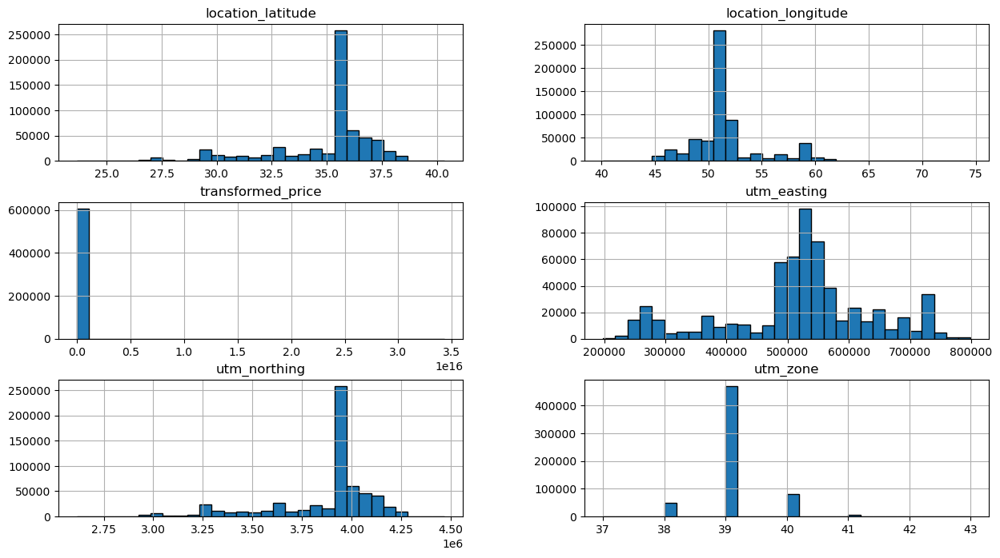

In [157]:
part_1_data.hist(figsize=(15, 8), bins=30, edgecolor='black')

Apply Power Transformers:

In [167]:
# Import yea_johnson power transformer
from sklearn.preprocessing import PowerTransformer

# Initialize the transformer
pt = PowerTransformer(method='yeo-johnson')
cols_to_transform = ['transformed_price']
pt.fit(part_1_data[cols_to_transform])
# Apply the transformation  
part_1_data[cols_to_transform] = pt.transform(part_1_data[cols_to_transform])

2025-12-22 16:10:11,800 - INFO     - Executing shutdown due to inactivity...
2025-12-22 16:10:11,832 - INFO     - Executing shutdown...
2025-12-22 16:10:11,833 - INFO     - Not running with the Werkzeug Server, exiting by searching gc for BaseWSGIServer


#### **Feature Scaling**

Feature Scaling to have better clustering using K-means.

In [159]:
# Feature Scaling on the Features : utm_easting , utm_northing, transformed_price
scaler = StandardScaler()

part_1_data_scaled = scaler.fit_transform(part_1_data[['utm_easting', 'utm_northing', 'transformed_price']])
part_1_data_scaled = pd.DataFrame(part_1_data_scaled, columns=['utm_easting', 'utm_northing', 'transformed_price'])
part_1_data_scaled.head()

,utm_easting,utm_northing,transformed_price
0,0.126308,0.297691,-0.322933
1,0.226408,0.309027,0.901321
2,-0.313023,0.301161,-0.490007
3,0.417386,0.330525,-0.152978
4,0.131627,0.310596,-0.394948


### **Train K-Means Model for Clustering**<br>

In [160]:
# Train the model
kmeans = KMeans(n_clusters=10, random_state=42)
part_1_data['cluster_number'] = kmeans.fit_predict(part_1_data_scaled)

# Finding Clusters Centroids
centroids_scaled = kmeans.cluster_centers_

In [161]:
part_1_data['cluster_number'].value_counts()

cluster_number
0    239823
7     64000
6     55201
5     50293
4     45066
8     41788
9     31542
1     29277
3     27416
2     10565
Name: count, dtype: int64

In [162]:
# Inverse Scaling cluster centroids
centroids = scaler.inverse_transform(centroids_scaled)

centroids_df = pd.DataFrame(
    centroids,
    columns=["utm_easting", "utm_northing", "price_value"]
)

In [163]:
centroids_utm = (
    part_1_data
    .groupby("cluster_number")[["utm_easting", "utm_northing"]]
    .mean()
    .reset_index()
)

centroids_utm["utm_zone"] = (
    part_1_data
    .groupby("cluster_number")["utm_zone"]
    .agg(lambda x: x.mode().iloc[0])
    .values
)

In [164]:
from pyproj import Transformer

latitudes = []
longitudes = []

for _, row in centroids_utm.iterrows():
    zone = int(row["utm_zone"])
    
    transformer = Transformer.from_crs(
        f"EPSG:326{zone}",  # UTM zone
        "EPSG:4326",        # WGS84
        always_xy=True
    )
    
    lon, lat = transformer.transform(
        row["utm_easting"],
        row["utm_northing"]
    )
    
    latitudes.append(lat)
    longitudes.append(lon)

centroids_utm["latitude"] = latitudes
centroids_utm["longitude"] = longitudes

In [165]:
import geopandas as gpd

# Build GeoDataFrame in WGS84
gdf = gpd.GeoDataFrame(
    part_1_data,
    geometry=gpd.points_from_xy(
        part_1_data["location_longitude"],
        part_1_data["location_latitude"]
    ),
    crs="EPSG:4326"
)

# Load Iran border (Natural Earth)
iran = gpd.read_file(
    "https://naturalearth.s3.amazonaws.com/110m_cultural/ne_110m_admin_0_countries.zip"
)
iran = iran[iran["NAME"] == "Iran"].to_crs("EPSG:4326")

# Spatial filter
iran_geom = iran.geometry.iloc[0]
gdf = gdf[gdf.within(iran_geom)].copy()

In [166]:
import plotly.express as px

# Force cluster_number to be categorical by converting it to string
# gdf["cluster_number"] = gdf["cluster_number"].astype(str)

# palette = sns.color_palette("Set2", 10).as_hex()

# cluster_colors = {
#     0: "#264653",  # deep blue-gray
#     1: "#2A9D8F",  # dark teal
#     2: "#1B4332",  # dark green
#     3: "#9B2226",  # dark red
#     4: "#5A189A",  # deep purple
#     5: "#7F5539",  # dark brown
#     6: "#C9184A",  # dark magenta
#     7: "#495057",  # charcoal gray
#     8: "#B08900",  # dark mustard
#     9: "#005F73",  # dark cyan
# }

fig = px.scatter_map(
    gdf,
    lat="location_latitude",
    lon="location_longitude",
    color="cluster_number",
    # color_discrete_sequence=palette,
    hover_data={
        "transformed_price": True,
        "utm_easting": ":.0f",
        "utm_northing": ":.0f",
        "location_latitude": False,
        "location_longitude": False,
    },
    map_style="open-street-map",
    zoom=3,
    center={"lat": 32.4279, "lon": 53.6880},
    title="K-Means Clusters (k=10) — Filtered to Iran<br><sup>Clustering done in UTM space</sup>",
    width=1550,
    height=800,
)

fig.add_trace(
    go.Scattermap(
        lat=centroids_utm["latitude"],
        lon=centroids_utm["longitude"],
        mode="markers+text",
        marker=dict(
            size=40,
            color="#000000",
            symbol="x"
        ),
    
        text=[f"C{i}" for i in centroids_utm["cluster_number"]],
        textposition="top center",
        hoverinfo="text",
        hovertext=[
            f"Cluster {row.cluster_number}<br>"
            f"UTM Easting: {row.utm_easting:,.0f}<br>"
            f"UTM Northing: {row.utm_northing:,.0f}"
            for _, row in centroids_utm.iterrows()
        ]
    )
)

fig.update_traces(
   marker=dict(size=7) 
)

fig.show()

---

## **Part 2** <br>
Find the best **K** for clustering by leveraging multiple methods.

#### **#1 Method:**  Elbow method (with WSS, also called inertia)

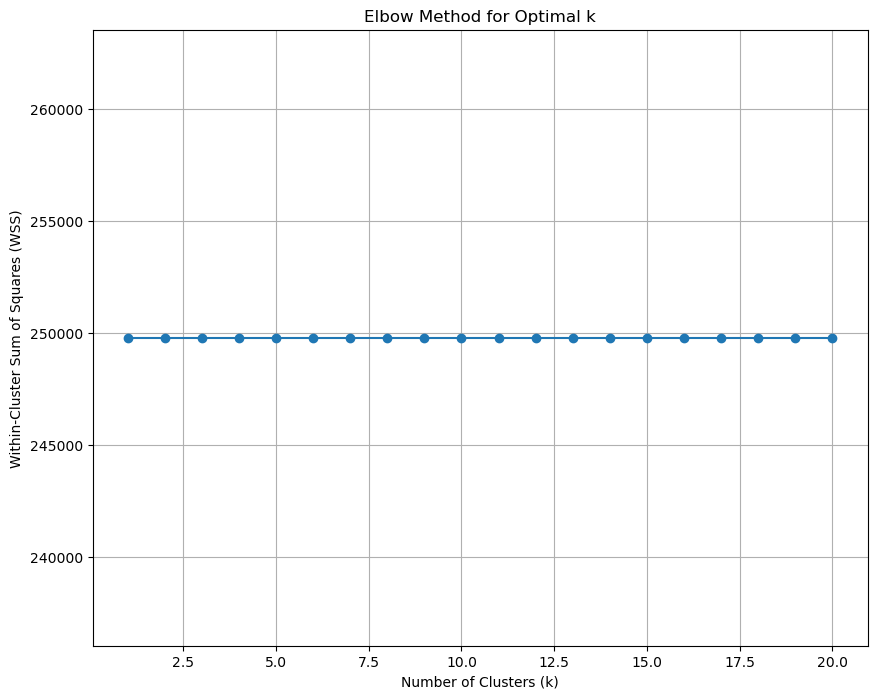

In [39]:
# Defne range of k values
k_range = range(1, 21)

# Compute inertia (WSS) for each k
wss = []
for k in k_range:
    kmeans = KMeans(n_clusters=10, random_state=42, n_init=10)
    # part_1_data['cluster_number'] = kmeans.fit_predict(clustering_features)
    kmeans.fit(part_1_data_scaled)
    wss.append(kmeans.inertia_)

# Plot the Elbow curve
plt.figure(figsize=(10, 8))
plt.plot(k_range, wss, marker='o')  # Plot k vs. WSS with markers
plt.title('Elbow Method for Optimal k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Within-Cluster Sum of Squares (WSS)')
plt.grid(True)
plt.show()

➡️

#### **#2 Method:** Silhouette Score

In [41]:
from sklearn.metrics import silhouette_score

# Define range of k values (start from 2)
k_range = range(2, 21)

# Compute average silhouette score for each k
sil_scores = []  # List to store scores
for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(part_1_data_scaled)
    labels = kmeans.labels_  # Get cluster labels for each point
    score = silhouette_score(part_1_data_scaled, labels)  # Compute average silhouette
    sil_scores.append(score)

# Plot the Silhouette curve
plt.figure(figsize=(8, 5))
plt.plot(k_range, sil_scores, marker='o')
plt.title('Silhouette Score for Optimal k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Average Silhouette Score')
plt.grid(True)
plt.show()

KeyboardInterrupt: 

➡️

#### **#3 Method:** Calinski-Harabasz Index

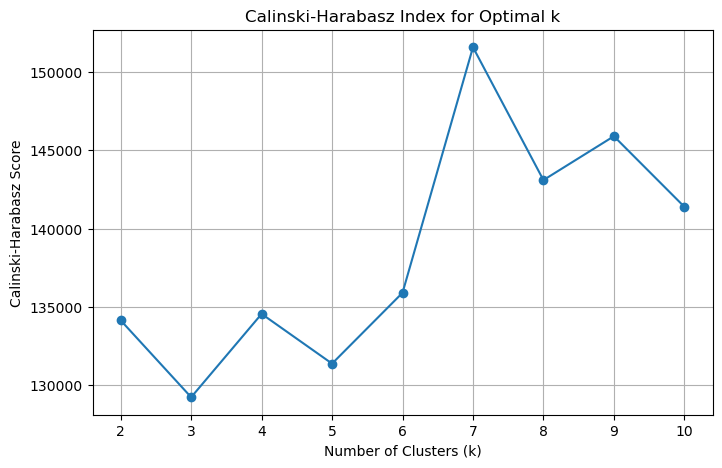

In [42]:
from sklearn.metrics import calinski_harabasz_score

# Define range of k values (start from 2)
k_range = range(2, 11)

# Compute Calinski-Harabasz scores
ch_scores = []
for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(part_1_data_scaled)
    labels = kmeans.labels_
    score = calinski_harabasz_score(part_1_data_scaled, labels)  # Compute CH score
    ch_scores.append(score)

# Plot the scores
plt.figure(figsize=(8, 5))
plt.plot(k_range, ch_scores, marker='o')
plt.title('Calinski-Harabasz Index for Optimal k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Calinski-Harabasz Score')
plt.grid(True)
plt.show()

➡️

#### **#4 Method:** Davies-Bouldin Index

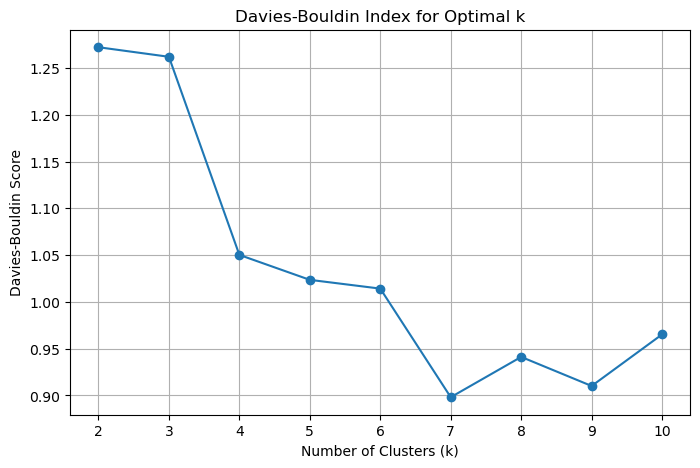

In [44]:
from sklearn.metrics import davies_bouldin_score

# Define range of k values (start from 2)
k_range = range(2, 11)

# Compute Davies-Bouldin scores
db_scores = []
for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(part_1_data_scaled)
    labels = kmeans.labels_
    score = davies_bouldin_score(part_1_data_scaled, labels)  # Compute DB score
    db_scores.append(score)

# Plot the scores
plt.figure(figsize=(8, 5))
plt.plot(k_range, db_scores, marker='o')
plt.title('Davies-Bouldin Index for Optimal k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Davies-Bouldin Score')
plt.grid(True)
plt.show()

➡️

In [46]:
# plot the clusters again

---